## Assignment 01: Sorting Algorithms & Running Times

In [4]:
# Import necessary libraries
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
from IPython.display import clear_output
%matplotlib inline
from IPython.display import Image

# Task 01 Counting The Steps

**Question:** Implement the Four algorithms listed in Table 1 in python using Jupyter notebook or design your own python library. Then vary the size of the input and record the number of steps. Plot the number of steps as a function the input size (n) to confirm that the plotted functions match the asymptotic running time shown on the Table 1.

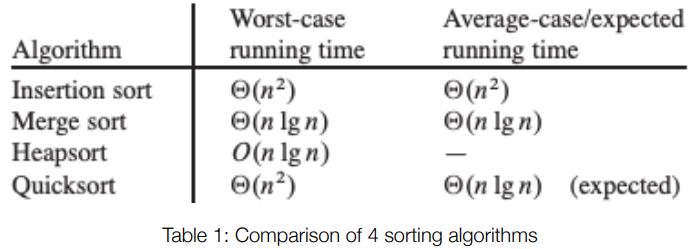

In [5]:
Image('images/Table01.PNG')

### A. Insertion Sort

12 / 12


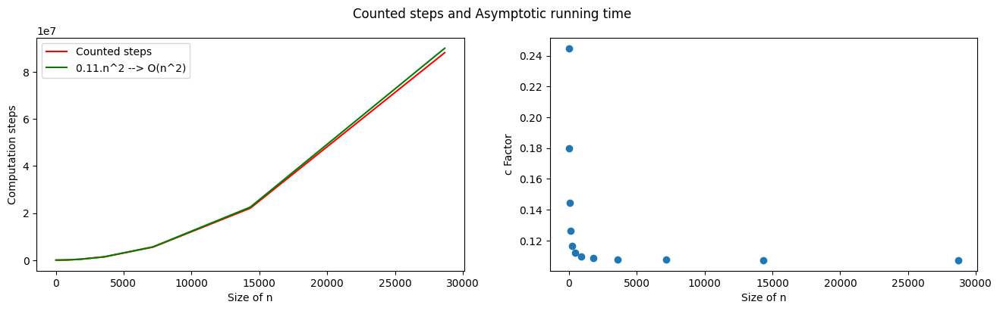

In [6]:
# Define a function to count the steps in the insertion sort algorithm
def insertion_sort_steps(A):
    steps = 0
    for j in range(1, len(A)):
        key = A[j]
        i = j - 1
        steps += 2  # Count comparison and assignment of key
        while i >= 0 and A[i] > key:
            A[i + 1] = A[i]
            i = i - 1
            steps += 2  # Count comparison and assignment of A[i]
        A[i + 1] = key
        steps += 1  # Count assignment of key back to A
    return steps

# Set the size of the figure
mpl.rcParams['figure.figsize'] = [16, 4]

# Create subplots for the figure
fig, ax = plt.subplots(1, 2)
fig.suptitle('Counted steps and Asymptotic running time')

# Initial array for testing
B = [7, 2, 5, 4, 6, 3, 1]
points = 12  # Number of plotting points
x = []  # Stores the input sizes
y = []  # Stores the counted steps
ref = []  # Stores the reference line
c = []  # Stores the approximation of c

# Loop to double the input size and count the steps
for i in range(0, points):
    clear_output(wait=True)
    print(i + 1, "/", points)
    steps = insertion_sort_steps(B.copy())  # Make a copy to not modify the original array
    # Double the size of the list to sort
    B = B * 2
    x.append(len(B))
    y.append(steps)
    c.append(steps / len(B) ** 2)  # Quick and dirty estimation of c: T(sort) = c.N^2

# Calculate the reference line
for v in x:
    ref.append([v ** 2 * c[6]])

# Plotting the counted steps and the reference line
ax[0].plot(x, y, color="red", label="Counted steps")
ax[0].plot(x, ref, color="green", label=str(round(c[6], 2)) + ".n^2 --> O(n^2)")
ax[0].set_xlabel("Size of n")
ax[0].set_ylabel("Computation steps")
ax[0].legend()

# Plotting the approximation of c
ax[1].scatter(x, c, label="Approximation of c")
ax[1].set_xlabel("Size of n")
ax[1].set_ylabel("c Factor")

# Show the plot
plt.show()

### B. Merge Sort

12 / 12


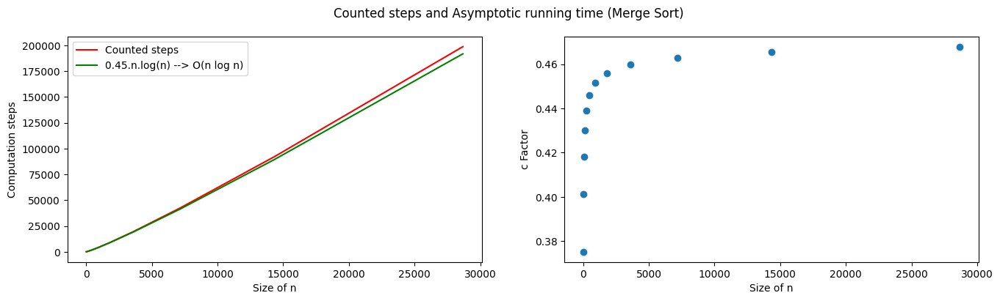

In [8]:
# Define a function to count the steps in the merge sort algorithm
def merge_sort_steps(arr):
    steps = 0
    if len(arr) > 1:
        mid = len(arr) // 2
        L = arr[:mid]
        R = arr[mid:]

        # Recursively count steps for the left and right subarrays
        steps += merge_sort_steps(L)
        steps += merge_sort_steps(R)

        # Merge the sorted subarrays
        i = j = k = 0
        while i < len(L) and j < len(R):
            if L[i] < R[j]:
                arr[k] = L[i]
                i += 1
            else:
                arr[k] = R[j]
                j += 1
            k += 1
            steps += 1  # Counting comparisons

        # Copy the remaining elements of L and R, if any
        while i < len(L):
            arr[k] = L[i]
            i += 1
            k += 1
            steps += 1  # Counting comparisons

        while j < len(R):
            arr[k] = R[j]
            j += 1
            k += 1
            steps += 1  # Counting comparisons

    return steps

# Set the size of the figure
mpl.rcParams['figure.figsize'] = [16, 4]

# Create subplots for the figure
fig, ax = plt.subplots(1, 2)
fig.suptitle('Counted steps and Asymptotic running time (Merge Sort)')

# Initial array for testing
B = [7, 2, 5, 4, 6, 3, 1]
points = 12  # Number of plotting points
x = []  # Stores the input sizes
y = []  # Stores the counted steps
ref = []  # Stores the reference line
c = []  # Stores the approximation of c

# Loop to double the input size and count the steps
for i in range(0, points):
    clear_output(wait=True)
    print(i + 1, "/", points)
    steps = merge_sort_steps(B.copy())  # Make a copy to not modify the original array
    # Double the size of the list to sort
    B = B * 2
    x.append(len(B))
    y.append(steps)
    c.append(steps / (len(B) * np.log2(len(B))))  # Quick and dirty estimation of c: T(sort) = c.N.logN

# Calculate the reference line
for v in x:
    ref.append([v * np.log2(v) * c[6]])

# Plotting the counted steps and the reference line
ax[0].plot(x, y, color="red", label="Counted steps")
ax[0].plot(x, ref, color="green", label=str(round(c[6], 2)) + ".n.log(n) --> O(n log n)")
ax[0].set_xlabel("Size of n")
ax[0].set_ylabel("Computation steps")
ax[0].legend()

# Plotting the approximation of c
ax[1].scatter(x, c, label="Approximation of c")
ax[1].set_xlabel("Size of n")
ax[1].set_ylabel("c Factor")

# Show the plot
plt.show()


### C. Heap Sort

12 / 12


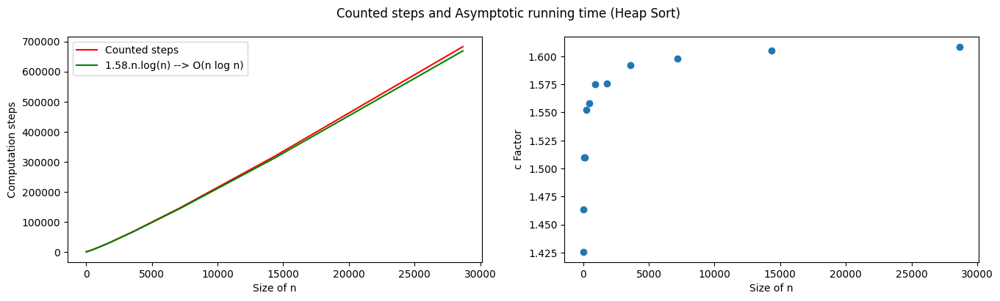

In [9]:
# Define the heapify function to maintain heap property
def heapify(arr, n, i):
    steps = 0
    largest = i
    l = 2 * i + 1
    r = 2 * i + 2

    steps += 3  # Counting comparisons and calculations

    # Compare with left child
    if l < n and arr[l] > arr[largest]:
        largest = l

    # Compare with right child
    if r < n and arr[r] > arr[largest]:
        largest = r

    # Swap and recursively heapify if necessary
    if largest != i:
        arr[i], arr[largest] = arr[largest], arr[i]
        steps += 1  # Counting swaps
        steps += heapify(arr, n, largest)

    return steps

# Define the heap sort function
def heap_sort_steps(arr):
    steps = 0
    n = len(arr)

    # Build max heap
    for i in range(n, -1, -1):
        steps += heapify(arr, n, i)

    # Extract elements one by one
    for i in range(n-1, 0, -1):
        arr[i], arr[0] = arr[0], arr[i]
        steps += 1  # Counting swaps
        steps += heapify(arr, i, 0)

    return steps

# Set the size of the figure
mpl.rcParams['figure.figsize'] = [16, 4]

# Create subplots for the figure
fig, ax = plt.subplots(1, 2)
fig.suptitle('Counted steps and Asymptotic running time (Heap Sort)')

# Initial array for testing
B = [7, 2, 5, 4, 6, 3, 1]
points = 12  # Number of plotting points
x = []  # Stores the input sizes
y = []  # Stores the counted steps
ref = []  # Stores the reference line
c = []  # Stores the approximation of c

# Loop to double the input size and count the steps
for i in range(0, points):
    clear_output(wait=True)
    print(i + 1, "/", points)
    steps = heap_sort_steps(B.copy())  # Make a copy to not modify the original array
    # Double the size of the list to sort
    B = B * 2
    x.append(len(B))
    y.append(steps)
    c.append(steps / (len(B) * np.log2(len(B))))  # Quick and dirty estimation of c: T(sort) = c.N.logN

# Calculate the reference line
for v in x:
    ref.append([v * np.log2(v) * c[6]])

# Plotting the counted steps and the reference line
ax[0].plot(x, y, color="red", label="Counted steps")
ax[0].plot(x, ref, color="green", label=str(round(c[6], 2)) + ".n.log(n) --> O(n log n)")
ax[0].set_xlabel("Size of n")
ax[0].set_ylabel("Computation steps")
ax[0].legend()

# Plotting the approximation of c
ax[1].scatter(x, c, label="Approximation of c")
ax[1].set_xlabel("Size of n")
ax[1].set_ylabel("c Factor")

# Show the plot
plt.show()

### D. Quick Sort

12 / 12


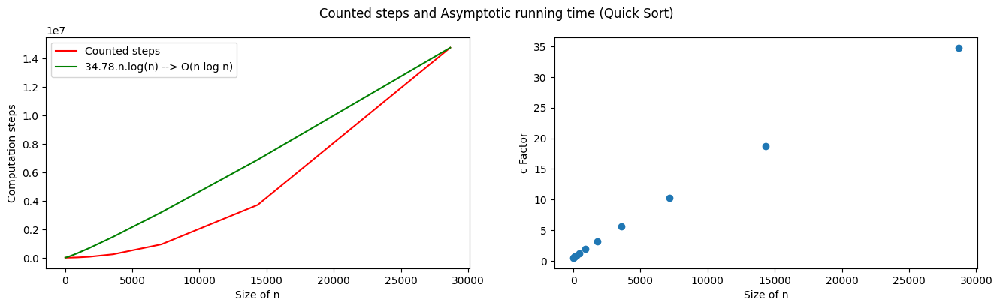

In [10]:
# Define the partition function for Quick Sort
def partition(arr, low, high):
    steps = 0
    pivot = arr[high]
    i = low - 1

    for j in range(low, high):
        steps += 1  # Counting comparisons
        if arr[j] < pivot:
            i += 1
            arr[i], arr[j] = arr[j], arr[i]
            steps += 1  # Counting swaps

    arr[i + 1], arr[high] = arr[high], arr[i + 1]
    steps += 1  # Counting swaps

    return i + 1, steps

# Define the Quick Sort function
def quick_sort_steps(arr, low, high):
    steps = 0
    if low < high:
        pi, partition_steps = partition(arr, low, high)
        steps += partition_steps
        steps += quick_sort_steps(arr, low, pi - 1)
        steps += quick_sort_steps(arr, pi + 1, high)
    return steps

# Set the size of the figure
mpl.rcParams['figure.figsize'] = [16, 4]

# Create subplots for the figure
fig, ax = plt.subplots(1, 2)
fig.suptitle('Counted steps and Asymptotic running time (Quick Sort)')

# Initial array for testing
B = [7, 2, 5, 4, 6, 3, 1]
points = 12  # Number of plotting points
x = []  # Stores the input sizes
y = []  # Stores the counted steps
ref = []  # Stores the reference line
c = []  # Stores the approximation of c

# Loop to double the input size and count the steps
for i in range(0, points):
    clear_output(wait=True)
    print(i + 1, "/", points)
    steps = quick_sort_steps(B.copy(), 0, len(B) - 1)  # Make a copy to not modify the original array
    # Double the size of the list to sort
    B = B * 2
    x.append(len(B))
    y.append(steps)
    c.append(steps / (len(B) * np.log2(len(B))))  # Quick and dirty estimation of c: T(sort) = c.N.logN

# Calculate the reference line
for v in x:
    ref.append([v * np.log2(v) * c[-1]])

# Plotting the counted steps and the reference line
ax[0].plot(x, y, color="red", label="Counted steps")
ax[0].plot(x, ref, color="green", label=str(round(c[-1], 2)) + ".n.log(n) --> O(n log n)")
ax[0].set_xlabel("Size of n")
ax[0].set_ylabel("Computation steps")
ax[0].legend()

# Plotting the approximation of c
ax[1].scatter(x, c, label="Approximation of c")
ax[1].set_xlabel("Size of n")
ax[1].set_ylabel("c Factor")

# Show the plot
plt.show()


# Task 02 Compare True Execution Time

**Question:** Choose one or several of the listed algorithm and implement them in two different programming languages. For example python and C or Go or C# or whatever language that you like. Run a test by varying the input size and measuring the execution time on your computer. Comment the differences.

For the algorithm, we are using Insertion Sort and for the languages, we are using Python and C.

### Python Code

In [12]:
import random
import time

In [14]:
def insertion_sort(arr):
    for i in range(1, len(arr)):
        key = arr[i]
        j = i - 1
        while j >= 0 and key < arr[j]:
            arr[j + 1] = arr[j]
            j -= 1
        arr[j + 1] = key

def test_insertion_sort(n):
    arr = [random.randint(1, 1000) for _ in range(n)]

    start_time = time.time()
    insertion_sort(arr)
    end_time = time.time()

    return end_time - start_time

# Test with varying input sizes
for size in [ 500, 1000, 1500, 2000, 2500]:
    execution_time = test_insertion_sort(size)
    print(f"Input Size: {size}, Execution Time: {execution_time:.6f} seconds")

Input Size: 500, Execution Time: 0.007004 seconds
Input Size: 1000, Execution Time: 0.029090 seconds
Input Size: 1500, Execution Time: 0.074572 seconds
Input Size: 2000, Execution Time: 0.107661 seconds
Input Size: 2500, Execution Time: 0.179384 seconds


### C Code

This C Code was ran in https://onecompiler.com/c/422w6mj9m 

In [8]:
# #include <stdio.h>
# #include <stdlib.h>
# #include <time.h>

# void insertion_sort(int arr[], int n) {
#     int i, key, j;
#     for (i = 1; i < n; i++) {
#         key = arr[i];
#         j = i - 1;

#         while (j >= 0 && key < arr[j]) {
#             arr[j + 1] = arr[j];
#             j = j - 1;
#         }
#         arr[j + 1] = key;
#     }
# }

# double test_insertion_sort(int arr[], int n) {
#     clock_t start_time, end_time;
#     start_time = clock();

#     insertion_sort(arr, n);

#     end_time = clock();
#     return ((double) (end_time - start_time)) / CLOCKS_PER_SEC;
# }

# int main() {
#     srand(time(NULL));

#     // Test with varying input sizes
#     for (int i = 0; i < 5; i++) {
#         int size = (i + 1) * 500;
#         int* arr = malloc(size * sizeof(int));

#         for (int j = 0; j < size; j++) {
#             arr[j] = rand() % 1000;
#         }

#         double execution_time = test_insertion_sort(arr, size);
#         printf("Input Size: %d, Execution Time: %f seconds\n", size, execution_time);

#         free(arr);
#     }

#     return 0;
# }

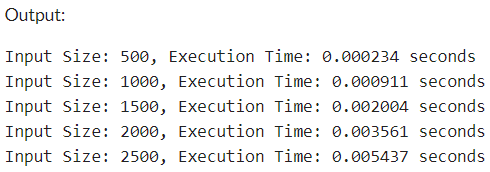

In [6]:
Image('images/C_Output.PNG')

The differences of execution time between Python and C code in Insertion Sort is attached here
### Output in Python code

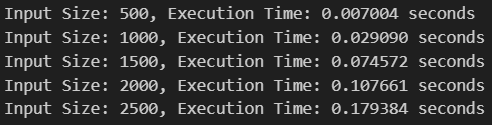

In [7]:
Image('images/Python_Output.PNG')

### Output in C code

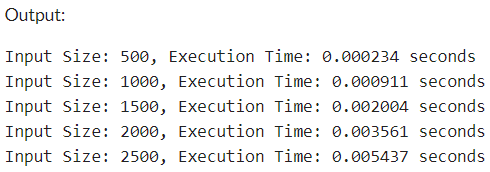

In [8]:
Image('images/C_Output.PNG')

### Differences

C implementation tends to show significantly faster execution times compared to the Python implementation. This is mainly due to the low-level nature of C, its explicit memory management, and the efficiency of compiled code. 

Python, while offering simplicity and readability, sacrifices some performance due to its interpreted nature and dynamic typing.

# Task 03 Basic proofs

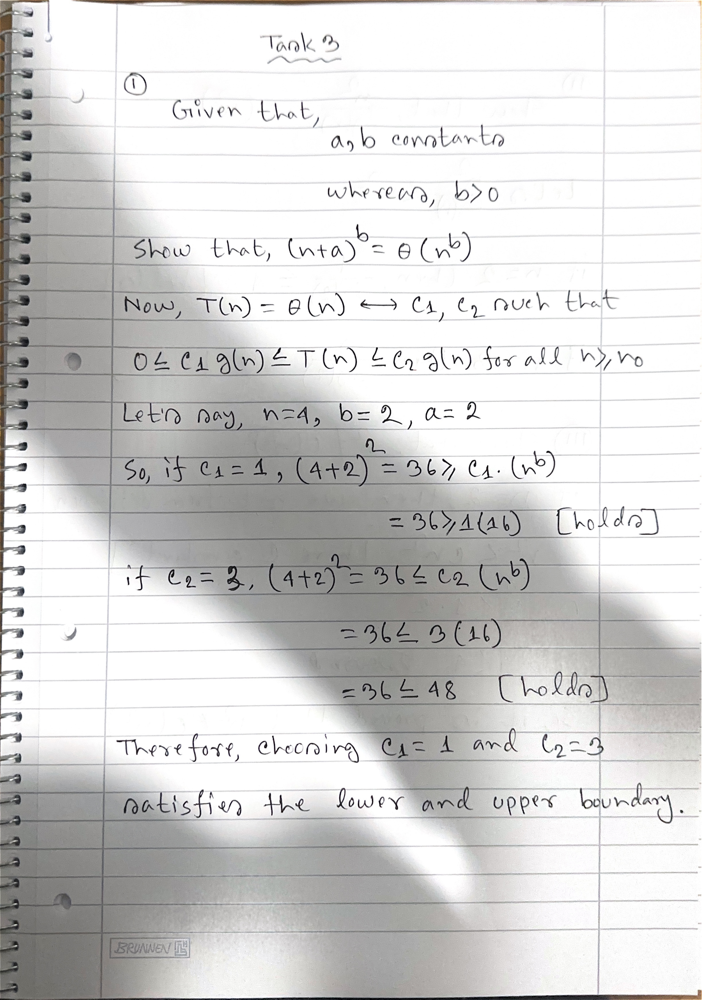

In [9]:
Image('images/Assignment01_Task03_1.jpg')

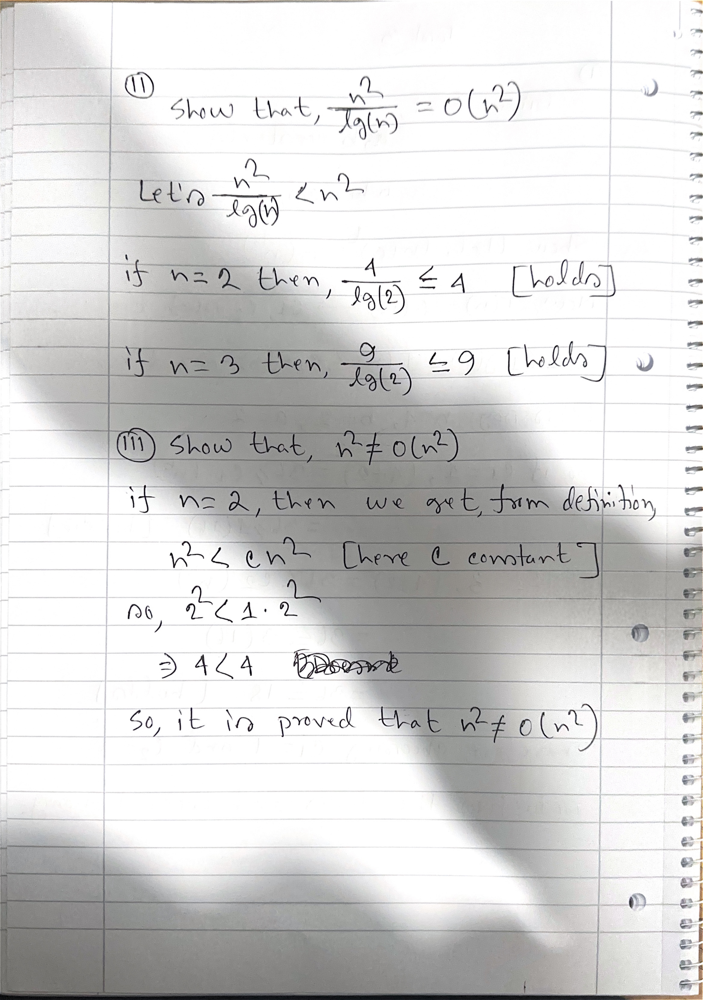

In [10]:
Image('images/Assignment01_Task03_2.jpg')

# Task 04 Divide and Conquer Analysis

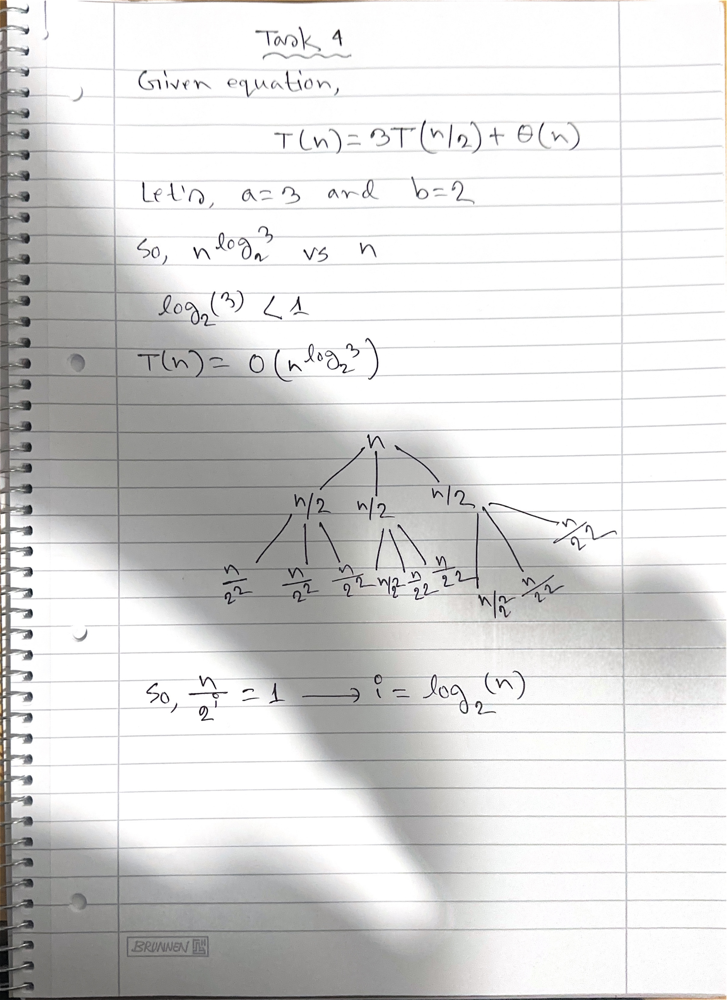

In [11]:
Image('images/Assignment01_Task04.jpg')